# Import libraries

In [8]:
import os
from re import search
from dfply import *
import scvelo as scv

In [2]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

# Load settings

In [3]:
if search("ricard", os.uname()[1]):
    exec(open('/Users/ricard/gastrulation10x/settings.py').read())
    exec(open('/Users/ricard/gastrulation10x/utils.py').read())
elif search("ebi", os.uname()[1]):
    exec(open('/homes/ricard/gastrulation10x/settings.py').read())
    exec(open('/homes/ricard/gastrulation10x/utils.py').read())
else:
    exit("Computer not recognised")

## Define I/O

In [4]:
io["outdir"] = io["basedir"] + "/..."

## Define options 

scanpy options

In [75]:
# %%capture
# sc.settings.verbosity = 3
# sc.logging.print_versions()
sc.settings.set_figure_params(dpi=300, frameon=False, figsize=(9, 7), facecolor='white')

In [9]:
opts["stages"] = [
   "E6.5",
   "E6.75",
   "E7.0",
   "E7.25",
   "E7.5",
   "E7.75",
   "E8.0",
   "E8.25",
   "E8.5",
   "mixed_gastrulation"
]

opts["celltypes"] = [
   "Epiblast",
   "Primitive_Streak",
   "Caudal_epiblast",
   # "PGC",
   "Anterior_Primitive_Streak",
   "Notochord",
   "Def._endoderm",
   "Gut",
   "Nascent_mesoderm",
   "Mixed_mesoderm",
   "Intermediate_mesoderm",
   "Caudal_Mesoderm",
   "Paraxial_mesoderm",
   "Somitic_mesoderm",
   "Pharyngeal_mesoderm",
   "Cardiomyocytes",
   "Allantois",
   "ExE_mesoderm",
   "Mesenchyme",
   # "Haematoendothelial_progenitors",
   # "Endothelium",
   # "Blood_progenitors_1",
   # "Blood_progenitors_2",
   # "Erythroid1",
   # "Erythroid2",
   # "Erythroid3",
   "NMP",
   "Rostral_neurectoderm",
   "Caudal_neurectoderm",
   "Neural_crest",
   "Forebrain_Midbrain_Hindbrain",
   "Spinal_cord",
   "Surface_ectoderm"
   # "Visceral_endoderm",
   # "ExE_endoderm",
   # "ExE_ectoderm",
   # "Parietal_endoderm"
]

## Load cell metadata

In [10]:
metadata = (pd.read_table(io["metadata"]) >>
    mask(X.stripped==False, X.doublet==False) >>
    mask(X["stage"].isin(opts["stages"]), X.celltype.isin(opts["celltypes"])) >>
    drop("celltype2","celltype3","sequencing.batch","doublet","stripped")
)
metadata.shape

(79375, 7)

In [11]:
metadata.head()

,cell,barcode,sample,stage,celltype,umapX,umapY
0,cell_1,AAAGGCCTCCACAA,1,E6.5,Epiblast,-10.227546,-2.881687
1,cell_2,AACAAACTCGCCTT,1,E6.5,Primitive_Streak,-6.625458,0.108961
3,cell_6,AACATATGAATCGC,1,E6.5,Epiblast,-10.454418,-0.269452
4,cell_8,AACCGATGGCTTCC,1,E6.5,Epiblast,-11.047206,-2.205269
5,cell_9,AACGTGTGCTCTAT,1,E6.5,Epiblast,-11.111009,-2.753442


# Load anndata object

In [12]:
# Does not include ExE lineages
io["anndata"] = "/hps/nobackup2/research/stegle/users/ricard/gastrulation10x/processed/adata_umap_pca.h5"

In [13]:
adata = load_adata(
    adata_file = io["anndata"], 
    # cells = metadata.cell.values, 
    normalise = True, 
    filter_lowly_expressed_genes = True
)
adata

KeyboardInterrupt: 

Subset cells

In [ ]:
cells = np.intersect1d(metadata.cell.values, adata.obs.index, assume_unique=True)
adata = adata[cells,:]
adata.shape

In [ ]:
adata.obs.head()

# Dimensionality reduction

Load precomputed batch-corrected PCA

In [ ]:
adata.obsm["X_pca"].shape

Run PCA

In [ ]:
# sc.tl.pca(adata, svd_solver='arpack')

Plot PCA

In [ ]:
sc.pl.pca(adata, components=[1,2], color="celltype", size=8, legend_loc=None)

Build kNN graph

In [ ]:
# sc.pp.neighbors(adata, n_neighbors=15, n_pcs=50)

Add precomputed UMAP coordinates

In [ ]:
# adata.obsm["X_umap"] = adata.obs.loc[:,["umapX","umapY"]].to_numpy()

Run UMAP

In [ ]:
# sc.tl.umap(adata, min_dist=0.5)

Plot UMAP

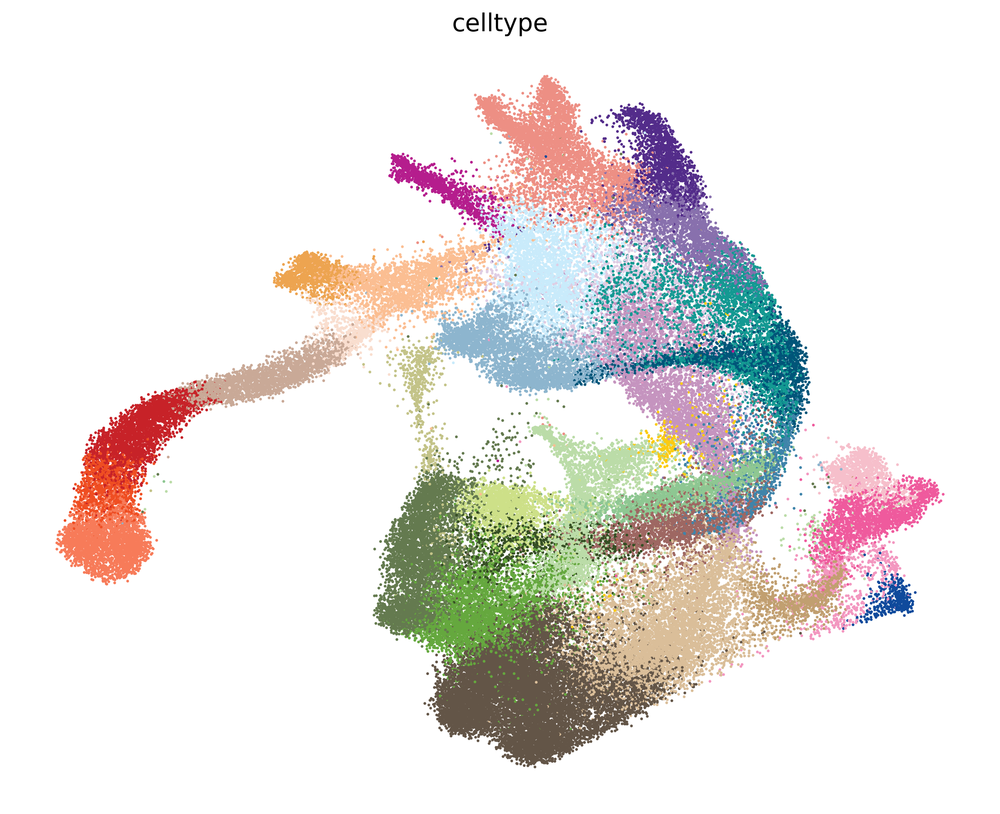

In [37]:
sc.pl.umap(adata_scv, color="celltype", size=10, legend_loc=None)

In [ ]:
sc.pl.umap(adata, color="stage", size=10, legend_loc=None)

# scVelo

In [ ]:
adata_scv = adata.copy()

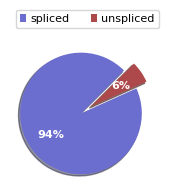

In [19]:
scv.pl.proportions(adata_scv)

Preprocessing requisites consist of gene selection by detection (with a minimum number of counts) and high variability (dispersion), normalizing every cell by its total size and logarithmizing X. Filtering and normalization is applied in the same vein to spliced/unspliced counts and X. Logarithmizing is only applied to X. If X is already preprocessed from former analysis, it will not be touched.

In [ ]:
scv.pp.filter_and_normalize(adata_scv, n_top_genes=3000, min_shared_counts=20)

Further, we need the first and second order moments (means and uncentered variances) computed among nearest neighbors in PCA space, summarized in scv.pp.moments, which internally computes scv.pp.pca and scv.pp.neighbors. First order is needed for deterministic velocity estimation, while stochastic estimation also requires second order moments.

In [ ]:
scv.pp.moments(adata_scv, n_pcs=50, n_neighbors=30)

## Estimate velocities

Velocities are vectors in gene expression space and represent the direction and speed of movement of the individual cells. The velocities are obtained by modeling transcriptional dynamics of splicing kinetics, either stochastically (default) or deterministically (by setting mode='deterministic'). For each gene, a steady-state-ratio of pre-mature (unspliced) and mature (spliced) mRNA counts is fitted, which constitutes a constant transcriptional state. Velocities are then obtained as residuals from this ratio. Positive velocity indicates that a gene is up-regulated, which occurs for cells that show higher abundance of unspliced mRNA for that gene than expected in steady state. Conversely, negative velocity indicates that a gene is down-regulated.  

The computed velocities are stored in adata.layers just like the count matrices.



In [ ]:
scv.tl.recover_dynamics(adata_scv)
scv.tl.velocity(adata_scv, mode="dynamical")

## Load precomputed scVelo model

In [14]:
io["scvelo"] = "/hps/nobackup2/research/stegle/users/ricard/gastrulation10x/processed/adata_dynamical_top1000.h5"

In [15]:
adata_csv = sc.read(io["scvelo"])

## Downstream analysis

In [ ]:
# scv.tl.velocity_graph(adata_scv)

#This is an alternative for using batch-corrected pcs and save to save some time - results might significantly differ
# scv.tl.velocity_graph(adata_scv, approx=True) 

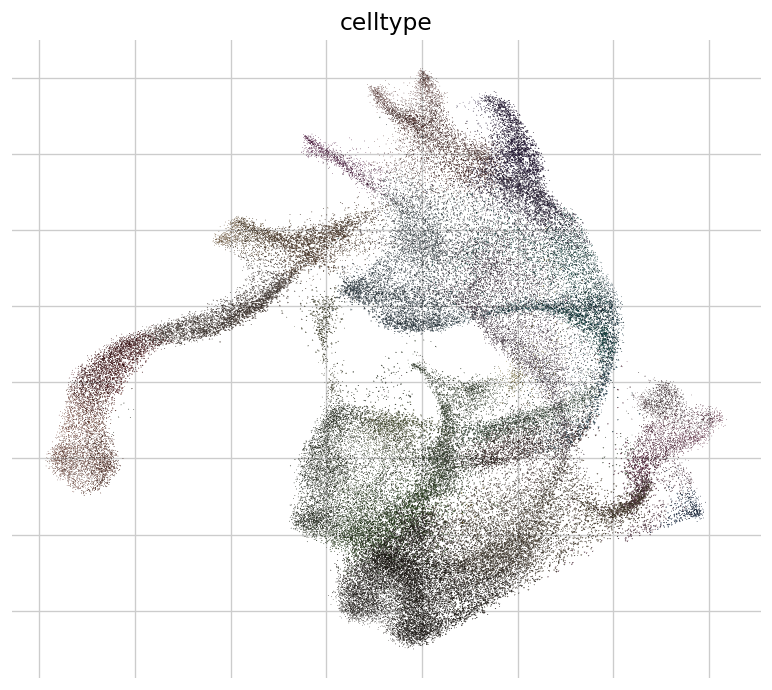

In [24]:
scv.pl.velocity_embedding(adata_scv, basis='umap', color='celltype', arrow_length=3, arrow_size=2, dpi=120)

scvelo.pl.velocity_embedding_grid(adata, basis=None, vkey='velocity', density=None, smooth=None, min_mass=None, arrow_size=None, arrow_length=None, arrow_color=None, scale=None, autoscale=True, n_neighbors=None, recompute=None, X=None, V=None, X_grid=None, V_grid=None, principal_curve=False, color=None, use_raw=None, layer=None, color_map=None, colorbar=True, palette=None, size=None, alpha=0.2, perc=None, sort_order=True, groups=None, components=None, projection='2d', legend_loc='none', legend_fontsize=None, legend_fontweight=None, xlabel=None, ylabel=None, title=None, fontsize=None, figsize=None, dpi=None, frameon=None, show=None, save=None, ax=None, ncols=None, **kwargs)

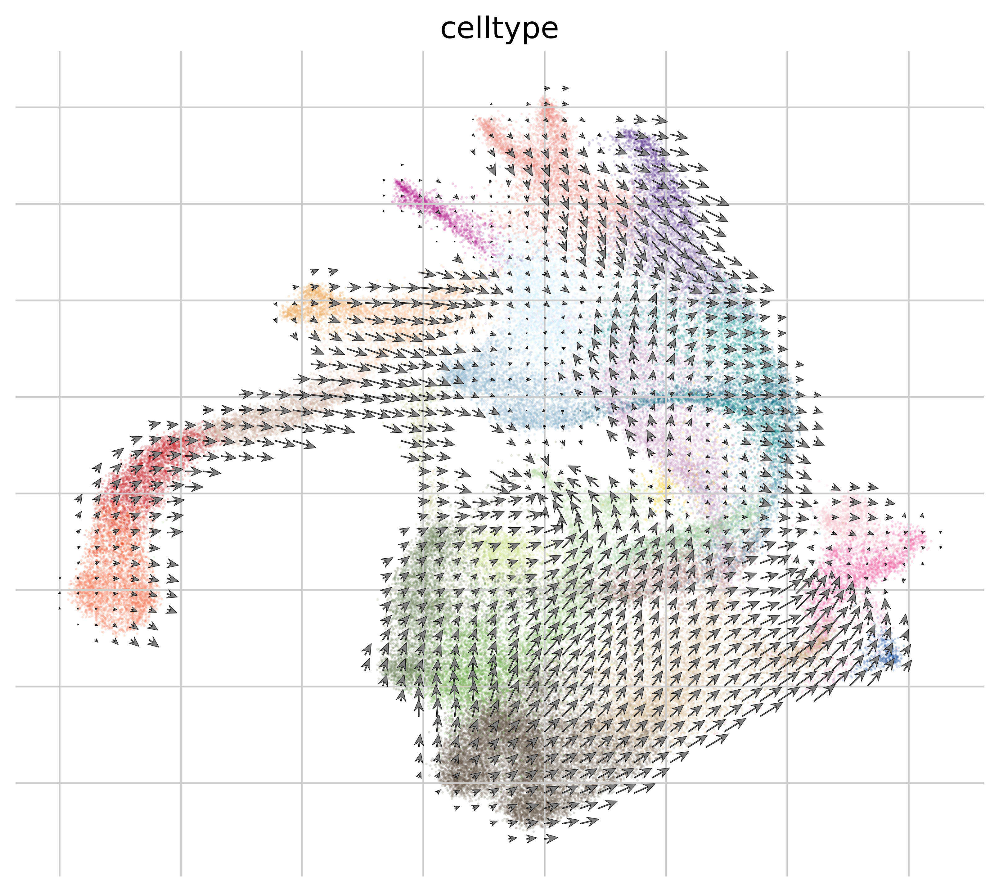

In [35]:
scv.pl.velocity_embedding_grid(adata_scv, basis='umap', color='celltype', arrow_length=5, arrow_size=2, dpi=500)

scvelo.pl.velocity_embedding_stream(adata, basis=None, vkey='velocity', density=None, smooth=None, min_mass=None, cutoff_perc=None, arrow_color=None, linewidth=None, n_neighbors=None, recompute=None, color=None, use_raw=None, layer=None, color_map=None, colorbar=True, palette=None, size=None, alpha=0.3, perc=None, X=None, V=None, X_grid=None, V_grid=None, sort_order=True, groups=None, components=None, legend_loc='on data', legend_fontsize=None, legend_fontweight=None, xlabel=None, ylabel=None, title=None, fontsize=None, figsize=None, dpi=None, frameon=None, show=None, save=None, ax=None, ncols=None, **kwargs)

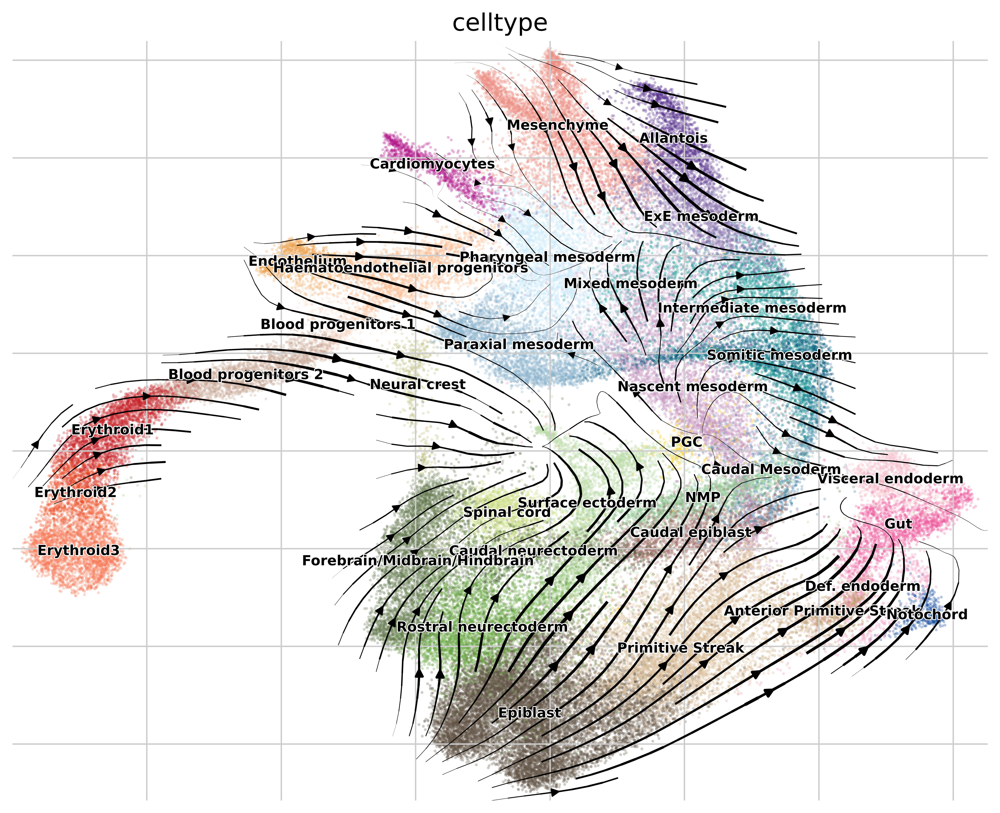

In [43]:
scv.pl.velocity_embedding_stream(adata_scv, basis='umap', color='celltype', 
    legend_loc='on data', linewidth=1, legend_fontsize=8, dpi=500)

## Phase portraits 

Now, let us examine the phase portraits of some marker genes, visualized with scv.pl.velocity(adata, gene_names) or scv.pl.scatter(adata, gene_names).

The black line corresponds to the estimated ‘steady-state’ ratio, i.e. the ratio of unspliced to spliced mRNA abundance which is in a constant transcriptional state. RNA velocity for a particular gene is determined as the residual, i.e. how much an observation deviates from that steady-state line. Positive velocity indicates that a gene is up-regulated, which occurs for cells that show higher abundance of unspliced mRNA for that gene than expected in steady state. Conversely, negative velocity indicates that a gene is down-regulated.

In [67]:
all_genes

Index(['Rp1', 'Sox17', 'Fhl2', 'Col5a2', 'Slc40a1', 'Mdh1b', 'Myl1', 'Fn1',
       'Igfbp5', 'Cfap65',
       ...
       'Bex4', 'Tceal9', 'Bex3', 'Nrk', 'Trap1a', 'Rnf128', 'Alas2', 'Spin2c',
       'Smpx', 'Rbbp7'],
      dtype='object', name='index', length=1000)

In [68]:
all_genes = adata_scv.var.index
#genes_to_plot = all_genes[all_genes.str.match("^Hb-*")][0]
genes_to_plot = "Sox17"

scvelo.pl.velocity(adata, var_names=None, basis=None, vkey='velocity', mode=None, fits=None, layers='all', color=None, color_map=None, colorbar=True, perc=[2, 98], alpha=0.5, size=None, groupby=None, groups=None, legend_loc='none', legend_fontsize=8, use_raw=False, fontsize=None, figsize=None, dpi=None, show=None, save=None, ax=None, ncols=None, **kwargs)

IndexError: list index out of range

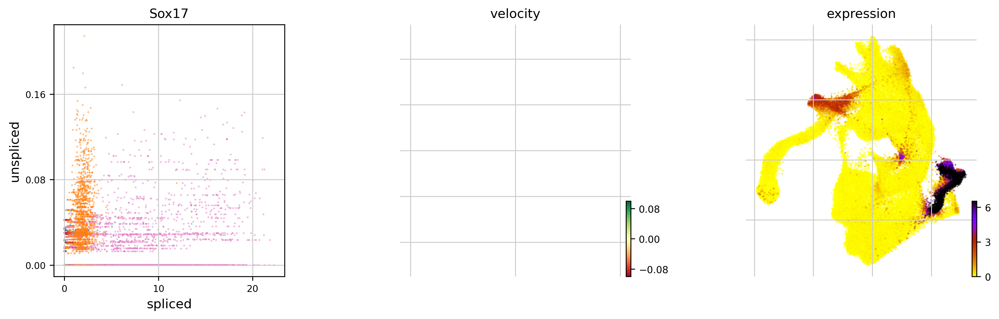

In [70]:
scv.pl.velocity(adata_scv, genes_to_plot, size=10, ncols=1)

scvelo.pl.scatter(adata=None, basis=None, x=None, y=None, vkey=None, color=None, use_raw=None, layer=None, color_map=None, colorbar=None, palette=None, size=None, alpha=None, linewidth=None, linecolor=None, perc=None, groups=None, sort_order=True, components=None, projection=None, legend_loc=None, legend_loc_lines=None, legend_fontsize=None, legend_fontweight=None, legend_fontoutline=None, xlabel=None, ylabel=None, title=None, fontsize=None, figsize=None, xlim=None, ylim=None, add_density=None, add_assignments=None, add_linfit=None, add_polyfit=None, add_rug=None, add_text=None, add_text_pos=None, add_outline=None, outline_width=None, outline_color=None, n_convolve=None, smooth=None, rescale_color=None, color_gradients=None, dpi=None, frameon=None, zorder=None, ncols=None, nrows=None, wspace=None, hspace=None, show=None, save=None, ax=None, **kwargs)

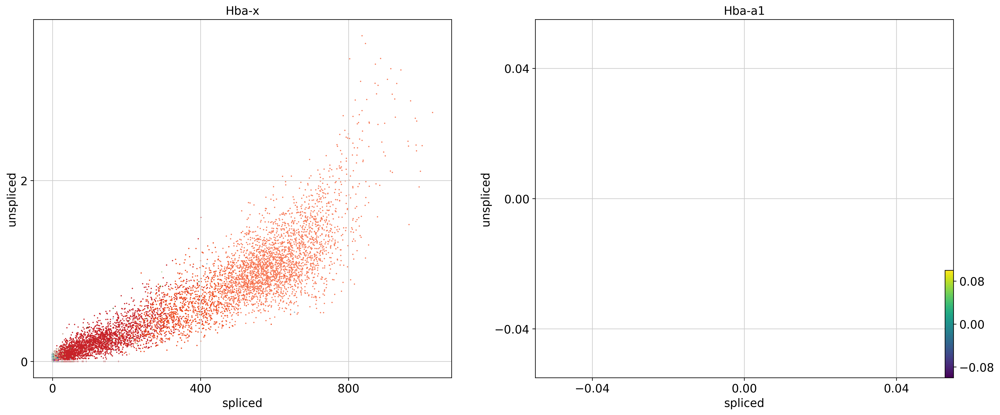

In [60]:
scv.pl.scatter(adata_scv, genes_to_plot, size=10, color=['celltype', 'velocity'])

Driver genes display pronounced dynamic behavior and are systematically detected via their characterization by high likelihoods in the dynamic model.



In [ ]:
top_genes = adata_scv.var['fit_likelihood'].sort_values(ascending=False).index
scv.pl.scatter(adata_scv, basis=top_genes[:10], ncols=5, frameon=False)


Cluster-specific top-likelihood genes

In [84]:
scv.tl.rank_dynamical_genes(adata_scv, groupby='celltype')
df = scv.get_df(adata_scv, 'rank_dynamical_genes/names')
df.head(5)

ranking genes by cluster-specific likelihoods
    finished (0:01:29) --> added 
    'rank_dynamical_genes', sorted scores by group ids (adata.uns)


,Allantois,Anterior Primitive Streak,Blood progenitors 1,Blood progenitors 2,Cardiomyocytes,Caudal Mesoderm,Caudal epiblast,Caudal neurectoderm,Def. endoderm,Endothelium,...,Notochord,PGC,Paraxial mesoderm,Pharyngeal mesoderm,Primitive Streak,Rostral neurectoderm,Somitic mesoderm,Spinal cord,Surface ectoderm,Visceral endoderm
0,Hoxa9,Mkrn1,Gypc,Abcb10,Rbms1,Mkrn1,Mkrn1,Mkrn1,Hmga2,Rbms1,...,Prtg,Rbms1,Prtg,Rbms1,Dnmt3b,Dnmt3b,Hmga2,Mkrn1,Hmga2,Prdm6
1,Bmp4,Fst,Hmga2,Gypc,Prdm6,Prtg,Prtg,Prtg,Rrm2,Hmga2,...,Smoc1,Prtg,Rbms1,Meis2,Mkrn1,Mkrn1,Rrm2,Hmga2,Prtg,Prss12
2,Rrm2,Hmga2,Rhoj,Rrm2,Fbn2,Hmga2,Hoxaas3,Meis2,Kcnk1,Fli1,...,Ccdc151,Rspo3,Meis1,Prtg,Kcnk1,Pim2,Fn1,Prtg,Rrm2,Cenpf
3,Hmga2,Kcnk1,Prkar2b,Snca,Prtg,Epha5,Epha5,Cenpf,Prtg,Cdh5,...,Ptch1,Tpd52,Rrm2,Rrm2,Fst,Meis2,Tpm4,Meis2,Kcnk1,Kcnk1
4,Gata4,Rrm2,Rrm2,Slc39a8,Meis1,Rrm2,Meis2,Pls3,Gata6,Rhoj,...,Mak,Ptk7,Meis2,Fbn2,Pim2,Kcnk1,Hoxaas3,H2afv,Tfap2a,H2afv


## Speed and coherence 

Two more useful stats: - The speed or rate of differentiation is given by the length of the velocity vector. - The coherence of the vector field (i.e., how a velocity vector correlates with its neighboring velocities) provides a measure of confidence.



In [71]:
scv.tl.velocity_confidence(adata_scv)

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


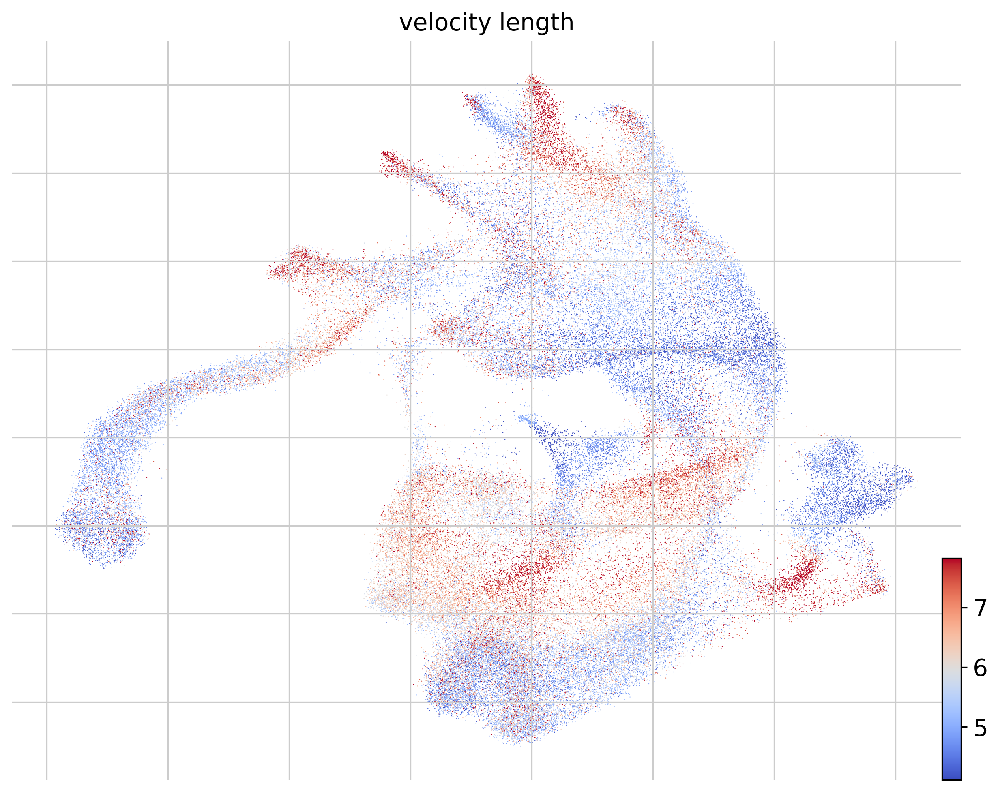

In [74]:
scv.pl.scatter(adata_scv, c='velocity_length', cmap='coolwarm', perc=[5, 95])


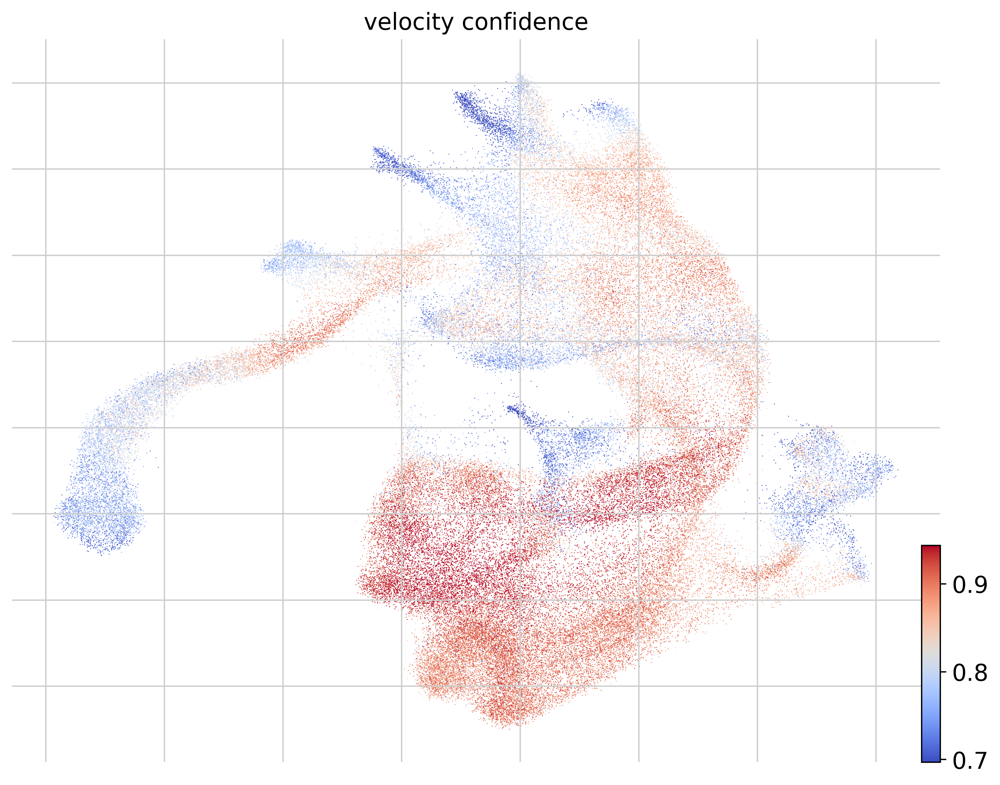

In [73]:
scv.pl.scatter(adata_scv, c='velocity_confidence', cmap='coolwarm', perc=[5, 95])

In [77]:
df = adata_scv.obs.groupby('celltype')[keys].mean().T
df.style.background_gradient(cmap='coolwarm', axis=1)

celltype,Allantois,Anterior Primitive Streak,Blood progenitors 1,Blood progenitors 2,Cardiomyocytes,Caudal Mesoderm,Caudal epiblast,Caudal neurectoderm,Def. endoderm,Endothelium,Epiblast,Erythroid1,Erythroid2,Erythroid3,ExE mesoderm,Forebrain/Midbrain/Hindbrain,Gut,Haematoendothelial progenitors,Intermediate mesoderm,Mesenchyme,Mixed mesoderm,NMP,Nascent mesoderm,Neural crest,Notochord,PGC,Paraxial mesoderm,Pharyngeal mesoderm,Primitive Streak,Rostral neurectoderm,Somitic mesoderm,Spinal cord,Surface ectoderm,Visceral endoderm
velocity_length,5.906562,7.002232,6.587673,5.872472,6.337745,6.361449,6.374196,6.099273,6.385376,6.796190,5.574719,5.324845,5.193300,5.271732,5.758172,6.367291,4.520247,5.857847,4.910354,6.350222,5.193325,6.778432,4.981292,5.994646,6.671484,7.123680,5.587112,5.670938,5.873794,6.305627,4.457250,6.125557,5.410740,4.712819
velocity_confidence,0.829029,0.868423,0.873995,0.850944,0.713370,0.899024,0.920240,0.934887,0.798435,0.779392,0.892732,0.795177,0.765985,0.747470,0.864655,0.898928,0.752422,0.837824,0.849866,0.772472,0.861549,0.895140,0.861228,0.817976,0.800807,0.885594,0.785096,0.785880,0.897241,0.929860,0.812772,0.896418,0.769354,0.742031


## Velocity graph and pseudotime


We can visualize the velocity graph to portray all velocity-inferred cell-to-cell connections/transitions. It can be confined to high-probability transitions by setting a threshold. The graph, for instance, indicates two phases of Epsilon cell production, coming from early and late Pre-endocrine cells.



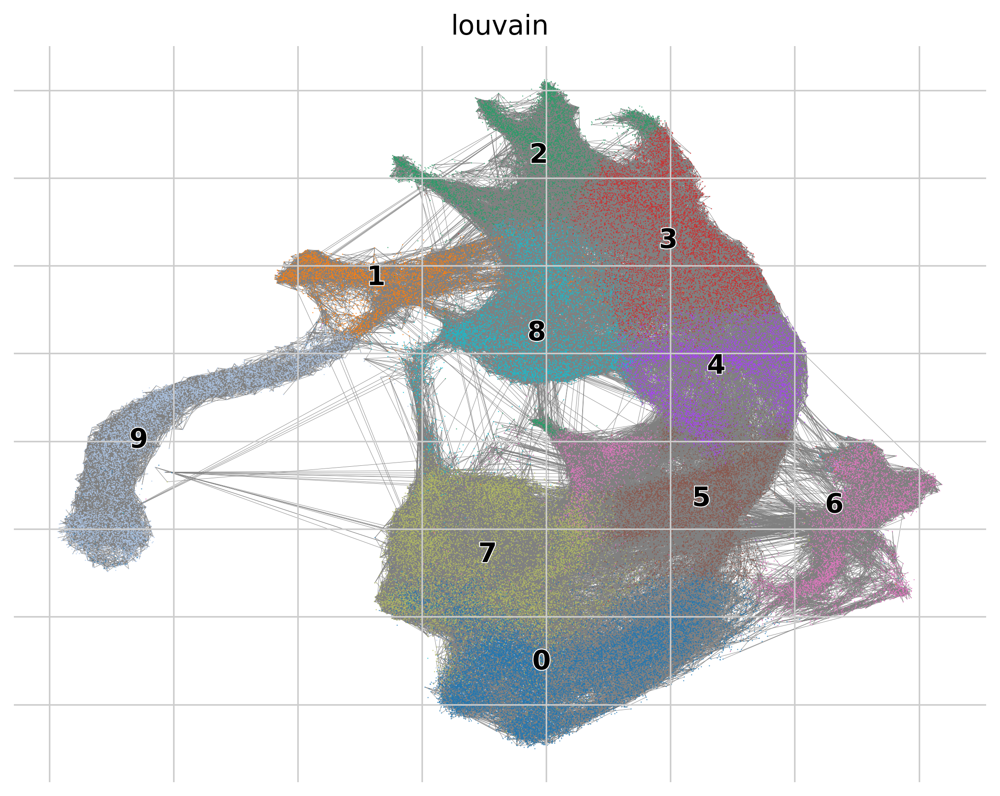

In [78]:
scv.pl.velocity_graph(adata_scv, threshold=.1)

Further, the graph can be used to draw descendents/anscestors coming from a specified cell. Here, a pre-endocrine cell is traced to its potential fate.

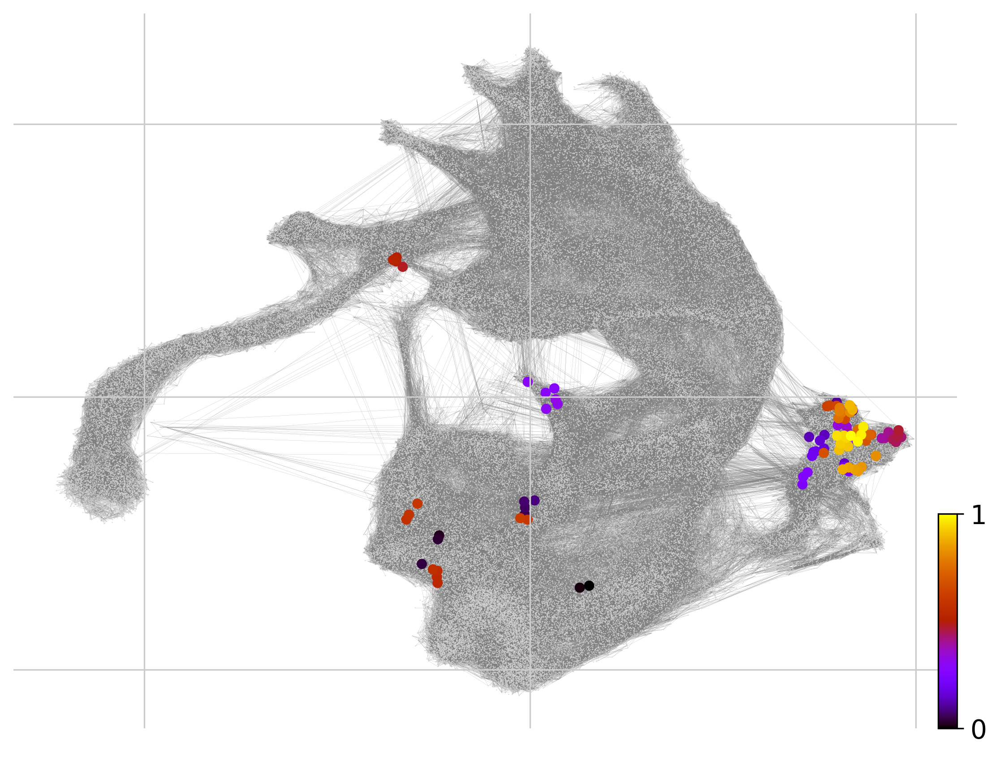

In [79]:
x, y = scv.utils.get_cell_transitions(adata_scv, basis='umap', starting_cell=70)
ax = scv.pl.velocity_graph(adata_scv, c='lightgrey', edge_width=.05, show=False)
ax = scv.pl.scatter(adata_scv, x=x, y=y, s=120, c='ascending', cmap='gnuplot', ax=ax)

## PAGA

PAGA is extended by velocity-inferred directionality.

In [80]:
adata_scv.uns['neighbors']['distances'] = adata_scv.obsp['distances']
adata_scv.uns['neighbors']['connectivities'] = adata_scv.obsp['connectivities']

scv.tl.paga(adata_scv, groups='clusters')
df = scv.get_df(adata_scv, 'paga/transitions_confidence', precision=2).T
df.style.background_gradient(cmap='Blues').format('{:.2g}')

DeprecationWarning: To avoid name collision with the igraph project, this visualization library has been renamed to 'jgraph'. Please upgrade when convenient.

In [81]:
scv.pl.paga(adata_scv, basis='umap', size=50, alpha=.1, min_edge_width=2, node_size_scale=1.5)

KeyError: 'paga'